In [1]:
import requests
from bs4 import BeautifulSoup
import time
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
import re
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from sklearn.preprocessing import MinMaxScaler
from io import BytesIO
from PIL import Image
import plotly.express as px
from datetime import datetime
import plotly.graph_objects as go


In [2]:
df = pd.read_csv('datos_limpios.csv')

In [3]:
df["precio_final"].max()

np.float64(6449900.0)

In [4]:
df.head(1)

,id_extraccion,timestamp_extraccion,marca,titulo,precio_contado,financiacion_disponible,descuento,precio_final,ubicacion,kilometraje,...,latitud,longitud,transmision,tipo_carroceria,asientos,potencia,puertas,mes_matriculacion2,año_matriculacion2,garantia_limpia
0,https://www.autocasion.com/coches-segunda-mano...,2025-06-13 17:48:32.862597,ABARTH,ABARTH 500 C 695C 1.4 16v T-Jet 132kW (180 CV),22490.0,True,-0.04,21590.4,Madrid,23213.0,...,40.4168,-3.7038,Manual,Desconocido,0.0,179.0,2.0,12.0,2022.0,12


In [5]:
df["precio_final"]

0         21590.40
1         11445.03
2         22070.40
3         15990.00
4         12648.00
            ...   
109060    19990.00
109061    21900.00
109062    26838.00
109063    22990.00
109064    21950.00
Name: precio_final, Length: 109065, dtype: float64

In [6]:
df.describe()

,precio_contado,descuento,precio_final,kilometraje,latitud,longitud,asientos,potencia,puertas,mes_matriculacion2,año_matriculacion2,garantia_limpia
count,1.090650e+05,109065.00000,1.090650e+05,1.090650e+05,109065.000000,109065.000000,109065.000000,109065.000000,109065.000000,109065.000000,109065.000000,109065.000000
mean,3.162326e+04,-0.00885,3.130547e+04,7.539431e+04,39.805115,-3.034814,3.662880,166.036996,4.719681,5.815367,2019.674341,13.311805
std,7.735249e+04,0.02609,7.621433e+04,6.147712e+04,2.867411,3.790684,2.215646,108.788716,0.749060,3.491572,4.336072,10.962498
min,1.000000e+00,-0.96000,1.000000e+00,0.000000e+00,28.123500,-16.629100,0.000000,0.000000,0.000000,1.000000,1995.000000,0.000000
25%,1.480000e+04,0.00000,1.460000e+04,2.758800e+04,38.879400,-4.421400,0.000000,110.000000,5.000000,3.000000,2018.000000,12.000000
50%,2.040000e+04,0.00000,2.008020e+04,6.585400e+04,40.416800,-3.703800,5.000000,136.000000,5.000000,5.000000,2021.000000,12.000000
75%,2.950000e+04,0.00000,2.905150e+04,1.070000e+05,41.385100,-0.408900,5.000000,184.000000,5.000000,9.000000,2023.000000,12.000000
max,6.449900e+06,0.00000,6.449900e+06,1.490000e+06,43.362300,3.017600,20.000000,999.000000,8.000000,12.000000,2025.000000,120.000000


## Valores de precios ##

Este gráfico muestra la relación entre kilometraje y precio final de vehículos, con los precios normalizados (escala 0-1).
Los puntos en la esquina inferior derecha (alto kilometraje, bajo precio) suelen ser vehículos económicos pero muy usados.
Los puntos en la esquina superior izquierda (bajo kilometraje, alto precio) representan vehículos premium o recientes

In [7]:
# 1. Eliminar outliers basados en el precio_contado
z_scores = np.abs(stats.zscore(df['precio_final']))
df_filtered = df[(z_scores < 3)]  # Mantenemos datos dentro de 3 desviaciones estándar

# 2. Normalizar los precios (escala 0-1)
precio_normalizado = (df_filtered['precio_final'] - df_filtered['precio_final'].min()) / (df_filtered['precio_final'].max() - df_filtered['precio_final'].min())
fig = px.scatter(df_filtered,
                 x='kilometraje',
                 y='precio_final',
                 color=precio_normalizado,
                 color_continuous_scale='viridis',
                 hover_data=['marca', 'titulo', 'ubicacion', 'año_matriculacion2'],
                 title='Distribución de Precios de Vehículos',
                 labels={'precio_final': 'Precio (€)', 
                         'kilometraje': 'Kilometraje',
                         'color': 'Precio Normalizado'})

fig.update_layout(
    plot_bgcolor='white',
    xaxis=dict(showgrid=True, gridcolor='lightgray'),
    yaxis=dict(showgrid=True, gridcolor='lightgray'),
    hovermode='closest'
)
fig.show()

Se realiza una comparación visual entre la distribución original de los precios de los vehículos y su versión transformada logarítmicamente.

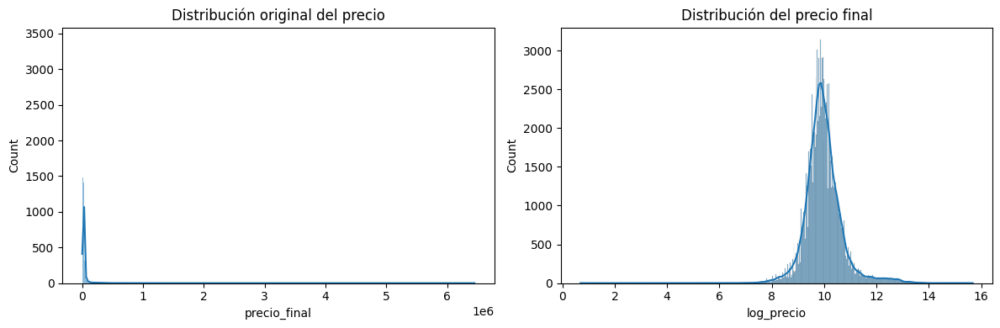

In [ ]:
# Crear la columna log_precio si no existe
if 'log_precio' not in df.columns:
	df['log_precio'] = np.log1p(df['precio_final'])

# Antes de la transformación
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
sns.histplot(df['precio_final'], kde=True)
plt.title('Distribución original del precio')

# Después de la transformación
plt.subplot(1, 2, 2)
sns.histplot(df['log_precio'], kde=True)
plt.title('Distribución del precio final')
plt.tight_layout()
plt.show()

# Relación Precio - Antigüedad

El gráfico muestra que el precio de los coches disminuye con la antigüedad, pero también revela diferencias claras entre marcas. Marcas premium como BMW y Audi mantienen valores más altos incluso en vehículos usados, mientras que Renault y Volkswagen ofrecen opciones más económicas.

In [ ]:
año_actual = datetime.now().year
df['antigüedad'] = año_actual - df['año_matriculacion2']

marcas_seleccionadas = ['MERCEDES BENZ', 'BMW', 'AUDI', 'VOLKSWAGEN', 'RENAULT', 'ALFA ROMEO']
df_selected = df[df['marca'].str.upper().isin([m.upper() for m in marcas_seleccionadas])]
def remove_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

df_filtered = remove_outliers(df_selected, 'precio_final')
df_filtered = remove_outliers(df_filtered, 'antigüedad')
df_filtered['precio_normalizado'] = (df_filtered['precio_final'] - df_filtered['precio_final'].min()) / (df_filtered['precio_final'].max() - df_filtered['precio_final'].min())

fig = px.scatter(
    df_filtered,
    x='antigüedad',
    y='precio_final',
    color='marca',
    size='precio_normalizado',
    hover_data=['titulo', 'kilometraje', 'ubicacion', 'transmision'],
    title='Relación Precio vs Antigüedad',
    labels={'antigüedad': 'Antigüedad (años)', 'precio_final': 'Precio Final (€)'},
    category_orders={'marca': sorted(marcas_seleccionadas)}  # Orden alfabético
)
fig.update_layout(
    plot_bgcolor='white',
    xaxis=dict(showgrid=True, gridcolor='lightgray'),
    yaxis=dict(showgrid=True, gridcolor='lightgray'),
    legend_title_text='Marca'
)
for marca in sorted(marcas_seleccionadas):
    subset = df_filtered[df_filtered['marca'].str.upper() == marca.upper()]
    if not subset.empty:
        trendline = np.poly1d(np.polyfit(subset['antigüedad'], subset['precio_final'], 1))(subset['antigüedad'])
        fig.add_scatter(
            x=subset['antigüedad'],
            y=trendline,
            mode='lines',
            line=dict(width=2),
            name=f'Tendencia {marca}',
            showlegend=False,
            opacity=0.6
        )

fig.show()

In [66]:
#Coeficiente de Correlacion de Pearson
correlacion = df_selected[["antigüedad", "precio_final"]].corr()
print(correlacion)

              antigüedad  precio_final
antigüedad      1.000000     -0.395659
precio_final   -0.395659      1.000000


# 1. Relación Garantía vs Precio

Los vehículos con garantías de 6-12 meses tienen una amplia variación de precios según la marca, reflejando diferencias en el valor de mercado. Según el posicionamiento de marcas: las marcas de lujo (Audi, BMW, Mercedes) mantienen precios altos incluso con garantías intermedias.
Este análisis es útil para entender la relación entre precio, marca y políticas de garantía en el mercado de vehículos

In [ ]:
modelos_top5 = df["marca"].value_counts().index[:5]
df_filtrado_modelos = df[df["marca"].isin(modelos_top5)].copy()
def remove_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

df_filtrado_modelos = remove_outliers(df_filtrado_modelos, 'precio_final')
df_filtrado_modelos = remove_outliers(df_filtrado_modelos, 'garantia_limpia')

scaler = MinMaxScaler()
df_filtrado_modelos['precio_normalizado'] = scaler.fit_transform(df_filtrado_modelos[['precio_final']])
df_filtrado_modelos["garantia_rango"] = pd.cut(
    df_filtrado_modelos["garantia_limpia"],
    bins=[0, 6, 12, 24, 36, 60],
    labels=["0-6 meses", "6-12 meses", "1-2 años", "2-3 años", "3-5 años"]
)
fig = px.box(
    df_filtrado_modelos,
    x="garantia_rango",
    y="precio_final",
    color="marca",
    title="Distribución de Precios por Rango de Garantía",
    labels={
        "precio_final": "Precio Final (€)",
        "garantia_rango": "Duración de la Garantía",
        "marca": "Marca del Vehículo"
    },
    hover_data=["titulo", "kilometraje", "ubicacion"],
    category_orders={"garantia_rango": ["0-6 meses", "6-12 meses", "1-2 años", "2-3 años", "3-5 años"]}
)
fig.update_layout(
    plot_bgcolor='white',
    paper_bgcolor='white',
    xaxis=dict(
        title_font=dict(size=14),
        gridcolor='lightgray'
    ),
    yaxis=dict(
        title_font=dict(size=14),
        gridcolor='lightgray',
        range=[0, df_filtrado_modelos["precio_final"].max() * 1.1]  # Margen del 10%
    ),
    legend=dict(
        title_font=dict(size=12),
        font=dict(size=11)
    ),
    boxmode='group',  # Agrupar cajas por marca
    hoverlabel=dict(
        bgcolor="white",
        font_size=12,
        font_family="Arial"
    )
)
fig.update_traces(
    customdata=df_filtrado_modelos[['precio_normalizado']],
    hovertemplate="<br>".join([
        "Marca: %{color}",
        "Garantía: %{x}",
        "Precio: %{y:,.0f}€",
        "Precio Normalizado: %{customdata[0]:.2f}",
        "Modelo: %{customdata[1]}",
        "Kilometraje: %{customdata[2]:,} km",
        "Ubicación: %{customdata[3]}",
    ])
)
fig_violin = px.violin(
    df_filtrado_modelos,
    x="garantia_rango",
    y="precio_final",
    color="marca",
    box=True,
    points="all"
)

fig.show()

In [72]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 109065 entries, 0 to 109064
Data columns (total 29 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   id_extraccion                   109065 non-null  object 
 1   timestamp_extraccion            109065 non-null  object 
 2   marca                           109065 non-null  object 
 3   titulo                          109065 non-null  object 
 4   precio_contado                  109065 non-null  float64
 5   financiacion_disponible         109065 non-null  int64  
 6   descuento                       109065 non-null  float64
 7   precio_final                    109065 non-null  float64
 8   ubicacion                       109065 non-null  object 
 9   kilometraje                     109065 non-null  float64
 10  combustible_Diésel              109065 non-null  bool   
 11  combustible_Eléctrico           109065 non-null  bool   
 12  combustible_Gas 

## Gráfico 2- precio final vs kilometraje por tipo de transmisión ##

Los vehículos eléctricos tienden a ser más caros que los manuales dependiendo del kilometraje. El kilometraje es un factor determinante pero el tipo de transimisión modera esta relación. 
Se espera una tendencia descendente a mayor kilometraje menor precio.

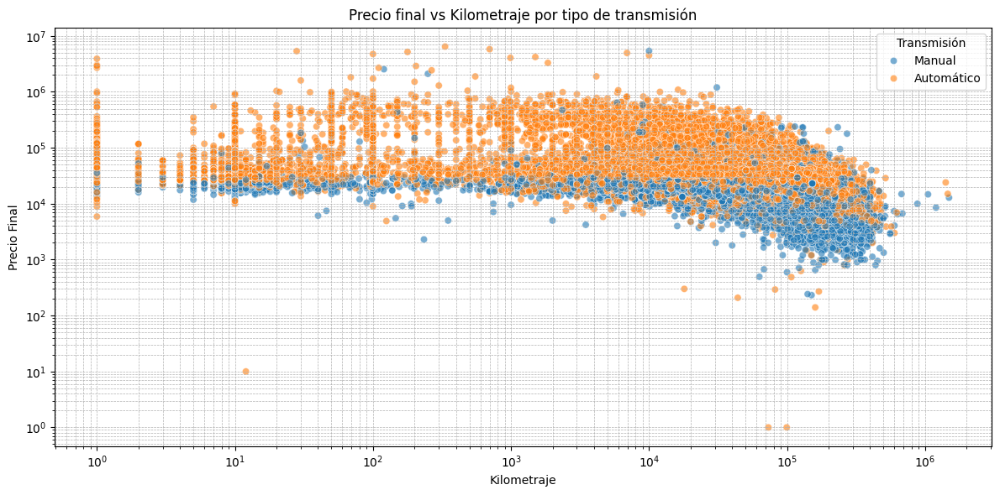

In [ ]:
plt.figure(figsize=(12, 6))
sns.scatterplot(data=df, x="kilometraje", y="precio_final", hue="transmision", alpha=0.6)
plt.xscale("log")
plt.yscale("log")
plt.grid(True, which="both", linestyle="--", linewidth=0.5)
plt.title('Precio final vs Kilometraje por tipo de transmisión')
plt.xlabel('Kilometraje')
plt.ylabel('Precio Final')
plt.legend(title='Transmisión', loc='best')
plt.tight_layout()
plt.show()

In [82]:
df.head(2)

,id_extraccion,timestamp_extraccion,marca,titulo,precio_contado,financiacion_disponible,descuento,precio_final,ubicacion,kilometraje,...,transmision,tipo_carroceria,asientos,potencia,puertas,mes_matriculacion2,año_matriculacion2,garantia_limpia,transmision_cod,antigüedad
0,https://www.autocasion.com/coches-segunda-mano...,2025-06-13T17:48:32.862597,ABARTH,ABARTH 500 C 695C 1.4 16v T-Jet 132kW (180 CV),22490.0,1,-0.04,21590.40,Madrid,23213.0,...,Manual,Desconocido,0.0,179.0,2.0,12.0,2022.0,12,0,3.0
1,https://www.autocasion.com/coches-segunda-mano...,2025-06-13T17:48:32.863158,ABARTH,"ABARTH 500 1,4 Turbo",11799.0,1,-0.03,11445.03,Barcelona,100924.0,...,Manual,Desconocido,0.0,135.0,3.0,4.0,2015.0,12,0,10.0


In [ ]:
df.head(10)

,id_extraccion,timestamp_extraccion,marca,titulo,precio_contado,financiacion_disponible,descuento,precio_final,ubicacion,kilometraje,...,tipo_carroceria,asientos,potencia,puertas,mes_matriculacion2,año_matriculacion2,garantia_limpia,transmision_cod,antigüedad,log_precio
0,https://www.autocasion.com/coches-segunda-mano...,2025-06-13T17:48:32.862597,ABARTH,ABARTH 500 C 695C 1.4 16v T-Jet 132kW (180 CV),22490.0,1,-0.04,21590.40,Madrid,23213.0,...,Desconocido,0.0,179.0,2.0,12.0,2022.0,12,0,3.0,9.980050
1,https://www.autocasion.com/coches-segunda-mano...,2025-06-13T17:48:32.863158,ABARTH,"ABARTH 500 1,4 Turbo",11799.0,1,-0.03,11445.03,Barcelona,100924.0,...,Desconocido,0.0,135.0,3.0,4.0,2015.0,12,0,10.0,9.345398
2,https://www.autocasion.com/coches-segunda-mano...,2025-06-13T17:48:32.863594,ABARTH,ABARTH 124 SPIDER Spider Turbo Multiair 125kW...,22990.0,1,-0.04,22070.40,Barcelona,97814.0,...,Desconocido,2.0,170.0,2.0,12.0,2018.0,12,1,7.0,10.002038
3,https://www.autocasion.com/coches-segunda-mano...,2025-06-13T17:48:32.863992,ABARTH,ABARTH 500 595 1.4T JET TURISMO 160,15990.0,1,0.00,15990.00,Alicante,36000.0,...,Berlina,4.0,160.0,3.0,10.0,2016.0,12,0,9.0,9.679781
4,https://www.autocasion.com/coches-segunda-mano...,2025-06-13T17:48:32.864370,ABARTH,ABARTH 500 500C 140 AUT.,13600.0,0,-0.07,12648.00,Vizcaya,145800.0,...,Desconocido,4.0,140.0,2.0,7.0,2012.0,12,1,13.0,9.445333
5,https://www.autocasion.com/coches-segunda-mano...,2025-06-13T17:48:32.864763,ABARTH,ABARTH 695 Pequeño Manual de 3 Puertas,19950.0,0,-0.13,17356.50,Islas Baleares,48500.0,...,Pequeño,4.0,180.0,3.0,2.0,2018.0,12,0,7.0,9.761780
6,https://www.autocasion.com/coches-segunda-mano...,2025-06-13T17:48:32.865310,ABARTH,ABARTH 595 1.4T JET PISTA 121KW,19950.0,1,0.00,19950.00,Barcelona,88000.0,...,Berlina,4.0,165.0,3.0,6.0,2020.0,12,0,5.0,9.901035
7,https://www.autocasion.com/coches-segunda-mano...,2025-06-13T17:48:32.865867,ABARTH,ABARTH 595 1.4T JET COMPETIZIONE 132KW,16095.0,0,-0.06,15129.30,Islas Baleares,125843.0,...,Berlina,4.0,180.0,3.0,7.0,2016.0,12,0,9.0,9.624455
8,https://www.autocasion.com/coches-segunda-mano...,2025-06-13T17:48:32.866332,ABARTH,ABARTH 595 1.4T JET COMPETIZIONE 132KW,19980.0,1,0.00,19980.00,Barcelona,88490.0,...,Berlina,4.0,180.0,3.0,12.0,2017.0,12,0,8.0,9.902537
9,https://www.autocasion.com/coches-segunda-mano...,2025-06-13T17:48:32.866774,ABARTH,ABARTH 500 1.4 T-JET 16V 595 121KW 165 3P,22500.0,1,0.00,22500.00,Islas Baleares,36955.0,...,Desconocido,0.0,165.0,3.0,4.0,2023.0,12,0,2.0,10.021315


In [92]:
df["marca"].unique()

array(['ABARTH', 'AIWAYS', 'ALFA ROMEO', 'ALPINE', 'ASTON MARTIN', 'AUDI',
       'BENTLEY', 'BESTUNE', 'BMW', 'BUGATTI', 'BUICK', 'BYD', 'CADILLAC',
       'CAN-AM', 'CATERHAM', 'CHEVROLET', 'CHRYSLER', 'CITROEN', 'CUPRA',
       'DACIA', 'DAEWOO', 'DAIMLER', 'DFSK', 'DODGE', 'DR', 'DS', 'EBRO',
       'EVO', 'FERRARI', 'FIAT', 'FISKER', 'FORD', 'GALLOPER', 'GENESIS',
       'GMC', 'HONDA', 'HUMMER', 'HURTAN', 'HYUNDAI', 'INEOS', 'INFINITI',
       'INVICTA', 'ISUZU', 'IVECO', 'JAECOO', 'JAGUAR', 'JEEP', 'KARMA',
       'KIA', 'KTM', 'LAMBORGHINI', 'LANCIA', 'LAND-ROVER', 'LEAPMOTOR',
       'LEXUS', 'LIGIER', 'LINCOLN', 'LYNK & CO', 'LIVAN', 'LOTUS',
       'MAHINDRA', 'MASERATI', 'MAXUS', 'MAYBACH', 'MAZDA', 'MCLAREN',
       'MERCEDES-BENZ', 'MG', 'MINI', 'MITSUBISHI', 'MORGAN',
       'MPM MOTORS', 'NISSAN', 'OMODA', 'OPEL', 'PAGANI', 'PEUGEOT',
       'PLYMOUTH', 'POLESTAR', 'PONTIAC', 'PORSCHE', 'RAM', 'RENAULT',
       'ROLLS-ROYCE', 'ROVER', 'SAAB', 'SANTANA', 'SEAT', 'SERES',

## Comparador de coches ##

## Relación entre precio y ubicación ##

Este gráfico de dispersión avanzado visualiza la relación entre el precio final de vehículos, su ubicación geográfica, marca y potencia.
Esto permite comparar como varian los precios entre las ciudades principales según su potencia y la marca.

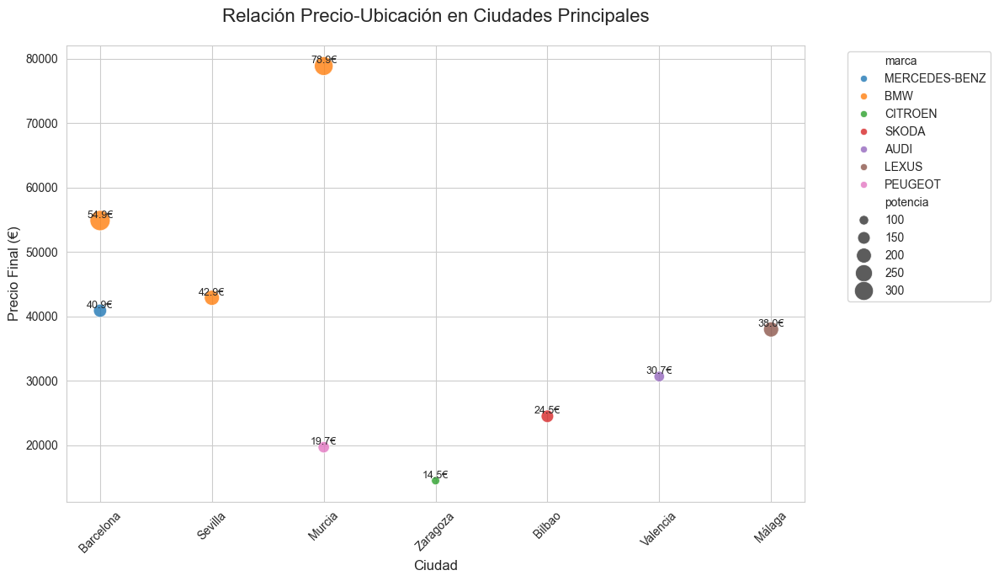

In [6]:
data = {
    'marca': ['MERCEDES-BENZ', 'BMW', 'BMW', 'CITROEN', 'MERCEDES-BENZ', 'SKODA', 'AUDI', 'LEXUS', 'PEUGEOT', 'BMW'],
    'precio_final': [40900, 42900, 78900, 14490, 22293, 24500, 30674, 37990, 19700, 54900],
    'ubicacion': ['Barcelona', 'Sevilla', 'Murcia', 'Zaragoza', 'Madrid', 'Bilbao', 'Valencia', 'Málaga', 'Murcia', 'Barcelona'],
    'potencia': [163, 204, 298, 83, 95, 150, 116, 204, 130, 340],
}
df = pd.DataFrame(data)
ciudades_principales = ["Barcelona", "Sevilla", "Valencia", "Murcia", "Málaga", "Zaragoza", "Bilbao"]
df_filtrado = df[df['ubicacion'].isin(ciudades_principales)]
plt.figure(figsize=(12, 7))
sns.set_style("whitegrid")
scatter = sns.scatterplot(
    data=df_filtrado,
    x='ubicacion',
    y='precio_final',
    hue='marca', 
    size='potencia',
    sizes=(50, 300),
    palette='tab10',
    alpha=0.8
)
plt.title('Relación Precio-Ubicación en Ciudades Principales', fontsize=16, pad=20)
plt.xlabel('Ciudad', fontsize=12)
plt.ylabel('Precio Final (€)', fontsize=12)
plt.xticks(rotation=45)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
for line in range(df_filtrado.shape[0]):
    scatter.text(
        df_filtrado['ubicacion'].iloc[line],
        df_filtrado['precio_final'].iloc[line],
        f"{df_filtrado['precio_final'].iloc[line]/1000:.1f}€",
        horizontalalignment='center',
        verticalalignment='bottom',
        fontsize=9
    )
plt.tight_layout()
plt.show()

In [7]:
df.head(10)

,marca,precio_final,ubicacion,potencia
0,MERCEDES-BENZ,40900,Barcelona,163
1,BMW,42900,Sevilla,204
2,BMW,78900,Murcia,298
3,CITROEN,14490,Zaragoza,83
4,MERCEDES-BENZ,22293,Madrid,95
5,SKODA,24500,Bilbao,150
6,AUDI,30674,Valencia,116
7,LEXUS,37990,Málaga,204
8,PEUGEOT,19700,Murcia,130
9,BMW,54900,Barcelona,340


## Mapa Coroplético ##

Este gráfico muestra la distribución geográfica de coches en venta por provincias españolas.
Este mapa es importante para tomar decisiones basadas en la geolocalización del mercado automotriz, destacando dónde está la demanda, la competencia y las oportunidades de crecimiento.
Muestra la cantidad de coches por provincia (distribución geográfica por volumen)-ayuda a identificar mercados activos

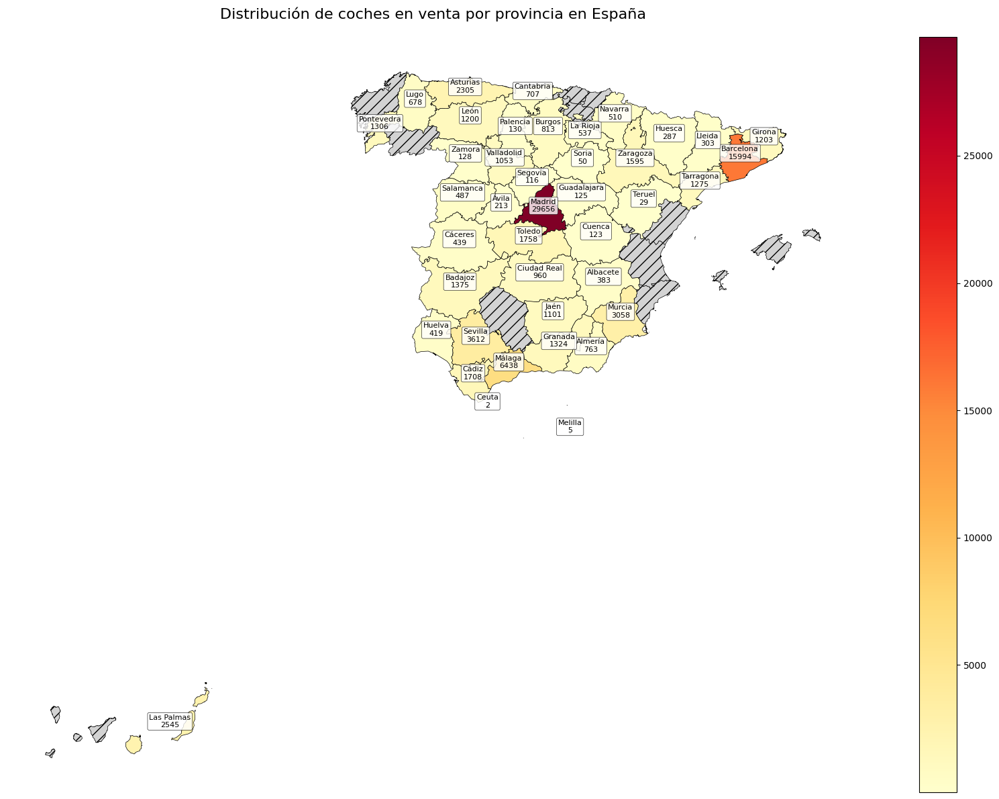

In [ ]:
coches_por_provincia = df['ubicacion'].value_counts().reset_index()
coches_por_provincia.columns = ['provincia', 'cantidad']

url_geojson = "https://raw.githubusercontent.com/codeforgermany/click_that_hood/main/public/data/spain-provinces.geojson"
provincias_espana = gpd.read_file(url_geojson)
normalizar_nombres = {
    "Córdoba": "Cordoba",
    "Coruña, A": "A Coruña",
    "Palmas, Las": "Las Palmas",
    "Valencia": "València"
}
coches_por_provincia['provincia'] = coches_por_provincia['provincia'].replace(normalizar_nombres)
mapa_data = provincias_espana.merge(
    coches_por_provincia,
    left_on='name',
    right_on='provincia',
    how='left'
)

fig, ax = plt.subplots(figsize=(18, 12))
cmap = 'YlOrRd'

# Mapa coroplético
mapa_data.plot(
    column='cantidad',
    cmap=cmap,
    linewidth=0.5,
    edgecolor='black',
    legend=True,
    ax=ax,
    missing_kwds={'color': 'lightgrey', 'hatch': '//', 'label': 'Sin datos'}
)
for idx, row in mapa_data.iterrows():
    if not pd.isna(row['cantidad']):
        ax.annotate(
            text=f"{row['name']}\n{int(row['cantidad'])}",
            xy=row['geometry'].centroid.coords[0],
            ha='center',
            fontsize=8,
            bbox=dict(boxstyle="round,pad=0.2", fc="white", lw=0.5, alpha=0.8)
        )
plt.title('Distribución de coches en venta por provincia en España', fontsize=16, pad=20)
ax.set_axis_off()
plt.tight_layout()
plt.savefig('mapa_coches_espana_detallado.png', dpi=300, bbox_inches='tight')
plt.show()

Este mapa coroplético muestra el precio promedio de vehículos en cada provincia española.
Las capitales provinciales y áreas metropolitanas tienden a concentrar los precios más altos.
Muestra el precio medio por provincia (distribución geográfica de valor)- ayuda a identificar mercados valiosos

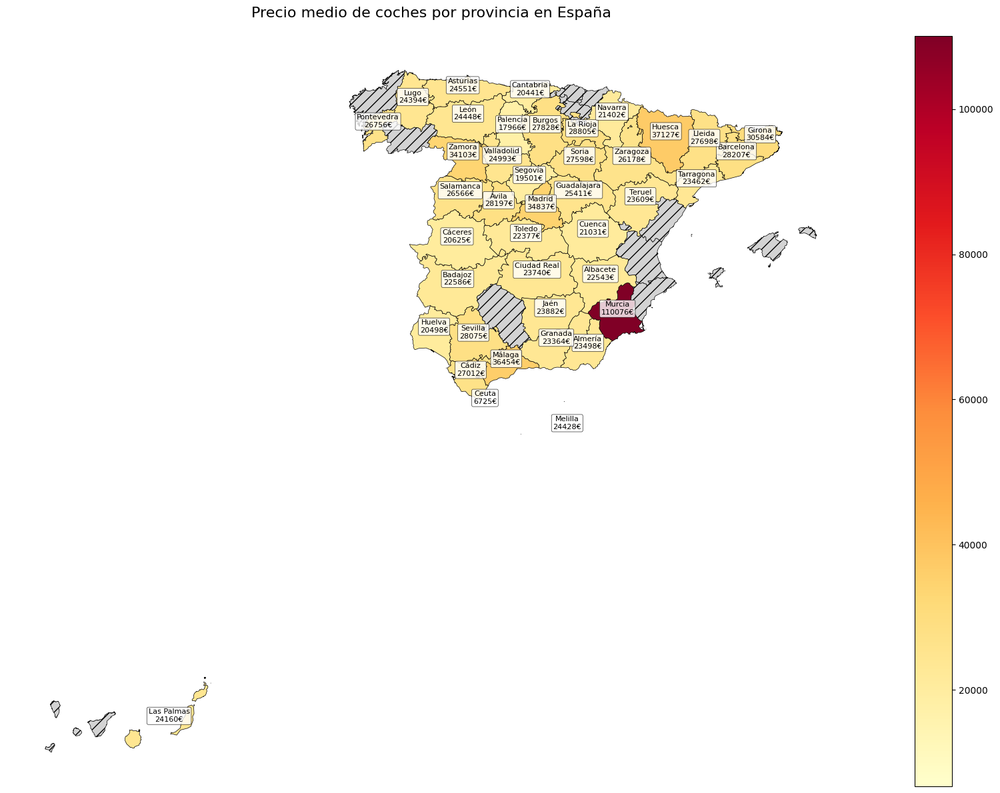

In [ ]:
precio_medio_provincia = df.groupby('ubicacion')['precio_final'].mean().reset_index()
precio_medio_provincia.columns = ['provincia', 'precio_medio']

url_geojson = "https://raw.githubusercontent.com/codeforgermany/click_that_hood/main/public/data/spain-provinces.geojson"
provincias_espana = gpd.read_file(url_geojson)

normalizar_nombres = {
    "Córdoba": "Cordoba",
    "Coruña, A": "A Coruña",
    "Palmas, Las": "Las Palmas",
    "Valencia": "València"
}
precio_medio_provincia['provincia'] = precio_medio_provincia['provincia'].replace(normalizar_nombres)

mapa_data = provincias_espana.merge(
    precio_medio_provincia,
    left_on='name',
    right_on='provincia',
    how='left'
)

fig, ax = plt.subplots(figsize=(18, 12))
cmap = 'YlOrRd' 

mapa_data.plot(
    column='precio_medio',
    cmap=cmap,
    linewidth=0.5,
    edgecolor='black',
    legend=True,
    ax=ax,
    missing_kwds={'color': 'lightgrey', 'hatch': '//', 'label': 'Sin datos'}
)
for idx, row in mapa_data.iterrows():
    if not pd.isna(row['precio_medio']):
        ax.annotate(
            text=f"{row['name']}\n{int(row['precio_medio'])}€",
            xy=row['geometry'].centroid.coords[0],
            ha='center',
            fontsize=8,
            bbox=dict(boxstyle="round,pad=0.2", fc="white", lw=0.5, alpha=0.8)
        )
plt.title('Precio medio de coches por provincia en España', fontsize=16, pad=20)
ax.set_axis_off()
plt.tight_layout()

# Guardar y mostrar
plt.savefig('mapa_precio_medio_espana.png', dpi=300, bbox_inches='tight')
plt.show()